<h2 align="center", style="font-size:28px">Vergleich maschineller Lernalgorithmen für die Vorhersage von Stromverbrauch</h2><h3 align="center", style="font-size:20px"><I>Fallbeispiel - Stadt Tétouan in Marokko - </I></h3>

<hr style="border-width: 3px; border-color: #ff0000;" >
<h3 style="font-size:20px"><span style="color:black"><center>Explorative Datenanalyse - <I>Part I</I> - </center></span></h3>
<hr style="border-width: 3px;border-color: #ff0000;" >

In [1]:
# - Import Bibliotheken -

# Datenaufbereitung
import numpy as np
import pandas as pd

# Visualisierung
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px

#Varianz-Inflations-Faktor
from statsmodels.stats.outliers_influence import variance_inflation_factor

#Warnungen
import warnings
warnings.filterwarnings('ignore')

<h5 style="font-size:18px">Datenuntersuchung</h5>

<span style="font-size:18px">Der Datensatz beinhaltet Daten von:</span>
<ul style="font-size:18px">
    <li> 3 Regionen: <I>Quads, Smir</I> und <I>Boussafou</I></li>
    <li>Stromverbrauch</li>
    <li>Wetter</li>
    <li>Datumsangaben: Januar bis Dezember 2017</li>
</ul>

In [2]:
#Daten Laden
data_path = "C:\\Users\\Maxim\\Desktop\\Abschlussarbeit\\Tetuan City power consumption.csv"
df_power = pd.read_csv(data_path)#,parse_dates=True,index_col="DateTime"
df_power.head()

,DateTime,Temperature,Humidity,Wind Speed,general diffuse flows,diffuse flows,Zone 1 Power Consumption,Zone 2 Power Consumption,Zone 3 Power Consumption
0,1/1/2017 0:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386
1,1/1/2017 0:10,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434
2,1/1/2017 0:20,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373
3,1/1/2017 0:30,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711
4,1/1/2017 0:40,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964


In [3]:
# die 3 Zielgrößen umbenennen
df_power.rename({'Zone 1 Power Consumption': 'Quads', 'Zone 2  Power Consumption': 'Boussafou', 'Zone 3  Power Consumption': 'Smir' }, axis=1, inplace=True)
df_power.head().round(2)

,DateTime,Temperature,Humidity,Wind Speed,general diffuse flows,diffuse flows,Quads,Boussafou,Smir
0,1/1/2017 0:00,6.56,73.8,0.08,0.05,0.12,34055.70,16128.88,20240.96
1,1/1/2017 0:10,6.41,74.5,0.08,0.07,0.08,29814.68,19375.08,20131.08
2,1/1/2017 0:20,6.31,74.5,0.08,0.06,0.10,29128.10,19006.69,19668.43
3,1/1/2017 0:30,6.12,75.0,0.08,0.09,0.10,28228.86,18361.09,18899.28
4,1/1/2017 0:40,5.92,75.7,0.08,0.05,0.08,27335.70,17872.34,18442.41


In [4]:
#technische Datensatzzussammenfassung
df_power.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52416 entries, 0 to 52415
Data columns (total 9 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   DateTime               52416 non-null  object 
 1   Temperature            52416 non-null  float64
 2   Humidity               52416 non-null  float64
 3   Wind Speed             52416 non-null  float64
 4   general diffuse flows  52416 non-null  float64
 5   diffuse flows          52416 non-null  float64
 6   Quads                  52416 non-null  float64
 7   Boussafou              52416 non-null  float64
 8   Smir                   52416 non-null  float64
dtypes: float64(8), object(1)
memory usage: 3.6+ MB


In [5]:
#fehlende Werte prüfen:
#1.Methode: df_power.isnull().sum()  
#2.Methode
df_power.count()

DateTime                 52416
Temperature              52416
Humidity                 52416
Wind Speed               52416
general diffuse flows    52416
diffuse flows            52416
Quads                    52416
Boussafou                52416
Smir                     52416
dtype: int64

In [6]:
#Dubletten vorhanden
df_power[df_power.duplicated(keep=False)]

,DateTime,Temperature,Humidity,Wind Speed,general diffuse flows,diffuse flows,Quads,Boussafou,Smir


In [7]:
#.Describe: statistische Maße zeigen
df_power.describe().round(2).transpose()

,count,mean,std,min,25%,50%,75%,max
Temperature,52416.0,18.81,5.82,3.25,14.41,18.78,22.89,40.01
Humidity,52416.0,68.26,15.55,11.34,58.31,69.86,81.40,94.80
Wind Speed,52416.0,1.96,2.35,0.05,0.08,0.09,4.92,6.48
general diffuse flows,52416.0,182.70,264.40,0.00,0.06,5.04,319.60,1163.00
diffuse flows,52416.0,75.03,124.21,0.01,0.12,4.46,101.00,936.00
Quads,52416.0,32344.97,7130.56,13895.70,26310.67,32265.92,37309.02,52204.40
Boussafou,52416.0,21042.51,5201.47,8560.08,16980.77,20823.17,24713.72,37408.86
Smir,52416.0,17835.41,6622.17,5935.17,13129.33,16415.12,21624.10,47598.33


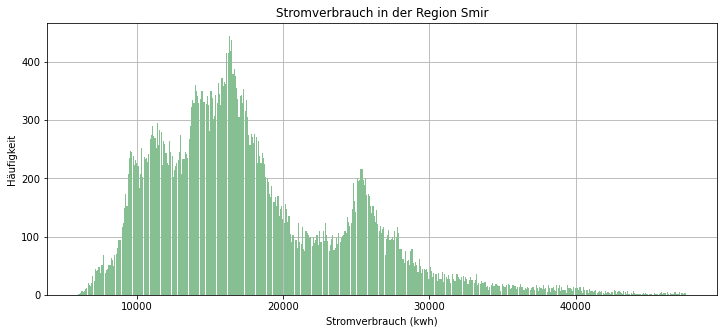

In [8]:
df_power.hist(column=['Smir'], bins=500, figsize=(12,5), color='#86bf91', zorder=2, rwidth=0.9);
plt.title('Stromverbrauch in der Region Smir')
plt.xlabel('Stromverbrauch (kwh)')
plt.ylabel("Häufigkeit");

In [9]:
# .Corr heatmap: Korrelation 
corr_mx = df_power.corr() 
fig = px.imshow(corr_mx,text_auto='.2f',aspect="auto",
                color_continuous_scale='BuPu',labels=dict(color="Colorbar")
                )
#fig.update_xaxes(side="top")
fig.update_layout(width=600, height=400, title={'text': "Korrelation zwischen Features und Targets ",
                                                'y':0.95,
                                                'x':0.55,
                                                'xanchor': 'center',
                                                'yanchor': 'top'})
fig.show()

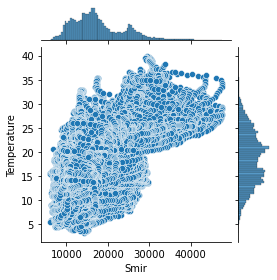

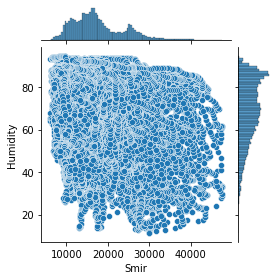

In [10]:
#Korrelation zwischen Smir und Temperatur
sns.jointplot(x=df_power['Smir'], y=df_power['Temperature'],height=4);
#Korrelation zwischen Smir und Luftfeuchtigkeit
sns.jointplot(x=df_power['Smir'], y=df_power['Humidity'],height=4);

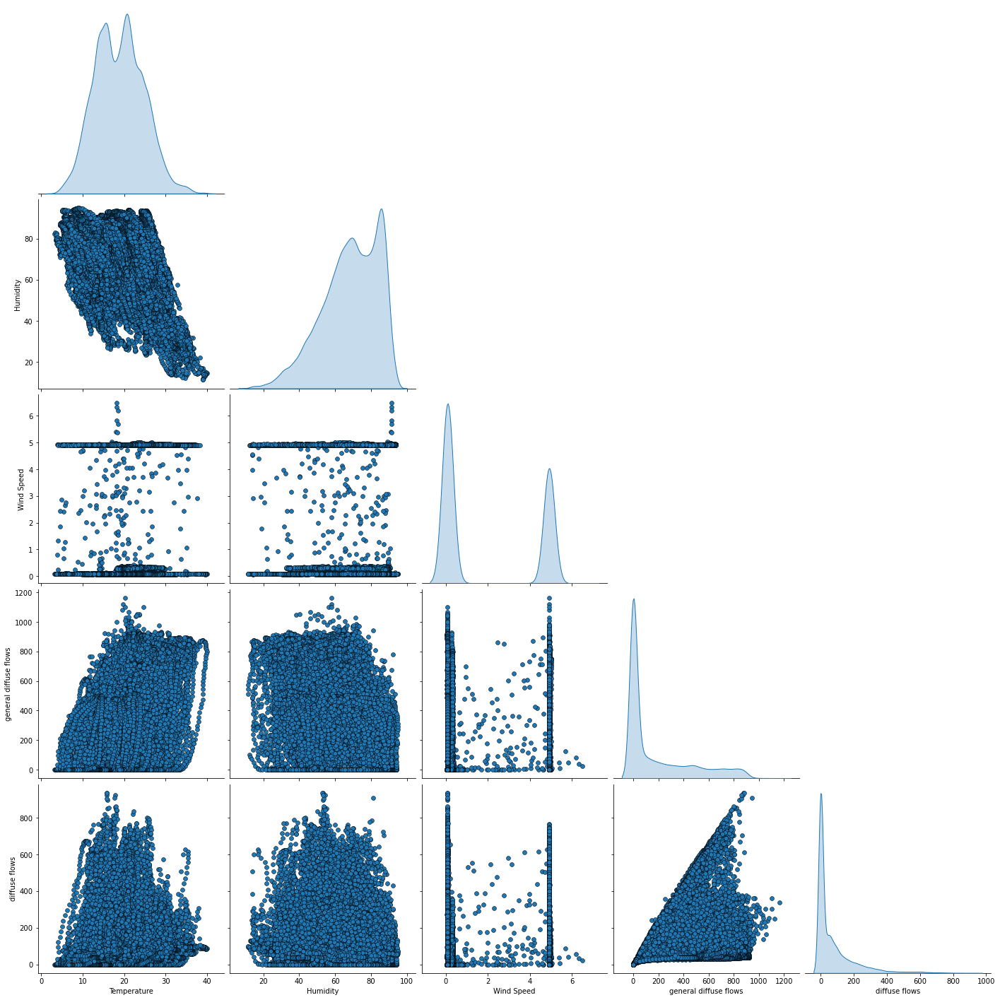

In [11]:
# bivariate Korrelationen
sns.pairplot(df_power.iloc[:,:6], corner=True,diag_kind = 'kde', plot_kws = {'edgecolor': 'k'}, height= 4)
plt.show()

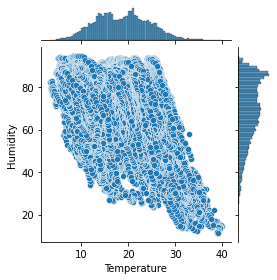

In [12]:
#Korrelation zwischen Smir und Luftfeuchtigkeit
sns.jointplot(x=df_power['Temperature'], y=df_power['Humidity'],height=4);

In [13]:
# Wie korrelieren die Einflussfaktoren untereinander?
X_variables = df_power[['Temperature','Humidity','Wind Speed','diffuse flows','general diffuse flows']]
vif_Xdata = pd.DataFrame()
vif_Xdata["Feature"] = X_variables.columns
vif_Xdata["VIF"] = [variance_inflation_factor(X_variables.values, i) for i in range(len(X_variables.columns))]
vif_Xdata

,Feature,VIF
0,Temperature,10.993185
1,Humidity,6.494296
2,Wind Speed,2.170687
3,diffuse flows,2.015173
4,general diffuse flows,2.851276


In [14]:
# Wie korrelieren die Einflussfaktoren ohne Temperature untereinander?
X_variables = df_power[['Humidity','Wind Speed','diffuse flows','general diffuse flows']]
vif_Xdata = pd.DataFrame()
vif_Xdata["Feature"] = X_variables.columns
vif_Xdata["VIF"] = [variance_inflation_factor(X_variables.values, i) for i in range(len(X_variables.columns))]
vif_Xdata

,Feature,VIF
0,Humidity,1.783825
1,Wind Speed,1.670751
2,diffuse flows,2.015162
3,general diffuse flows,2.154490


In [15]:
# Wie korrelieren die Einflussfaktoren ohne Luftfeuchtigkeit untereinander?
X_variables = df_power[['Temperature','Wind Speed','diffuse flows','general diffuse flows']]
vif_Xdata = pd.DataFrame()
vif_Xdata["Feature"] = X_variables.columns
vif_Xdata["VIF"] = [variance_inflation_factor(X_variables.values, i) for i in range(len(X_variables.columns))]
vif_Xdata

,Feature,VIF
0,Temperature,3.019559
1,Wind Speed,2.101237
2,diffuse flows,1.989617
3,general diffuse flows,2.432280


In [16]:
corr_matrix = df_power.corr().abs()
corr_matrix

,Temperature,Humidity,Wind Speed,general diffuse flows,diffuse flows,Quads,Boussafou,Smir
Temperature,1.000000,0.460243,0.477109,0.460294,0.196522,0.440221,0.382428,0.489527
Humidity,0.460243,1.000000,0.135853,0.468138,0.256886,0.287421,0.294961,0.233022
Wind Speed,0.477109,0.135853,1.000000,0.133733,0.000972,0.167444,0.146413,0.278641
general diffuse flows,0.460294,0.468138,0.133733,1.000000,0.564718,0.187965,0.157223,0.063376
diffuse flows,0.196522,0.256886,0.000972,0.564718,1.000000,0.080274,0.044667,0.038506
Quads,0.440221,0.287421,0.167444,0.187965,0.080274,1.000000,0.834519,0.750733
Boussafou,0.382428,0.294961,0.146413,0.157223,0.044667,0.834519,1.000000,0.570932
Smir,0.489527,0.233022,0.278641,0.063376,0.038506,0.750733,0.570932,1.000000


<h5>Zeitreihenanalyse</h5>

In [17]:
# Datum umwandeln und als Index setzen
df_power['DateTime'] = pd.to_datetime(df_power['DateTime'], utc=True, infer_datetime_format=True)
df_power = df_power.set_index('DateTime')
df_power.head().round(2)

,Temperature,Humidity,Wind Speed,general diffuse flows,diffuse flows,Quads,Boussafou,Smir
DateTime,,,,,,,,
2017-01-01 00:00:00+00:00,6.56,73.8,0.08,0.05,0.12,34055.70,16128.88,20240.96
2017-01-01 00:10:00+00:00,6.41,74.5,0.08,0.07,0.08,29814.68,19375.08,20131.08
2017-01-01 00:20:00+00:00,6.31,74.5,0.08,0.06,0.10,29128.10,19006.69,19668.43
2017-01-01 00:30:00+00:00,6.12,75.0,0.08,0.09,0.10,28228.86,18361.09,18899.28
2017-01-01 00:40:00+00:00,5.92,75.7,0.08,0.05,0.08,27335.70,17872.34,18442.41


In [18]:
# Liniendiagramm für die drei Zeilvariablen
fig = px.line(df_power.iloc[:,5:])
fig.update_layout(title_text='Stromverbrauch in Tetouan (2017)', title_x=0.5,
                   xaxis_title='Monat',
                   yaxis_title='Stromverbrauch kWh', legend_title_text='Regionen:')
fig.show()

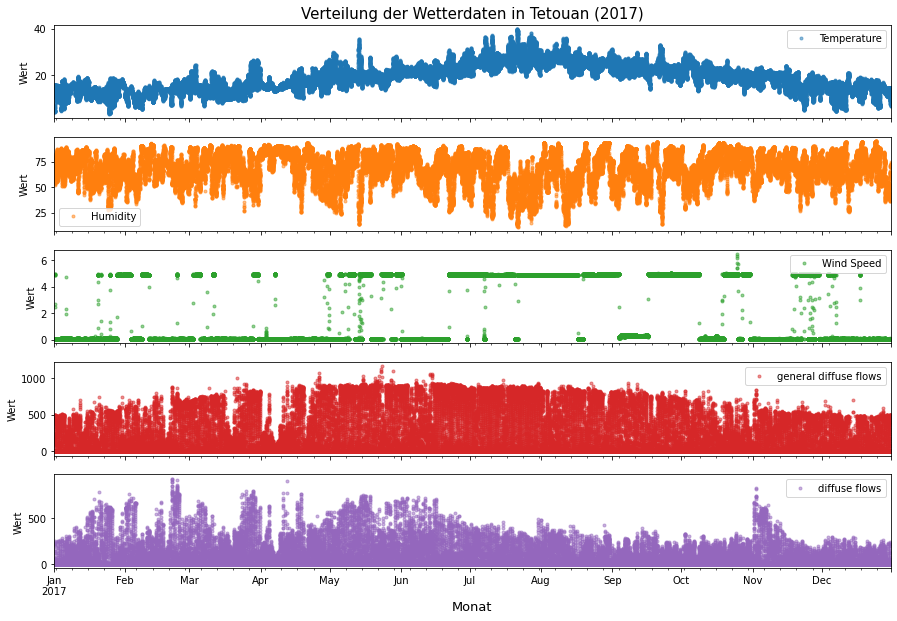

In [19]:
# Wetterdaten-Plot
cols_plot = ['Temperature', 'Humidity', 'Wind Speed', 'general diffuse flows','diffuse flows']
axes = df_power[cols_plot].plot(marker='.', alpha=0.5, linestyle='None', figsize=(15, 10), subplots=True,fontsize=10)
for ax in axes:
    ax.set_xlabel('Monat',fontsize=13)
    ax.set_ylabel('Wert')
plt.title('Verteilung der Wetterdaten in Tetouan (2017)', fontsize=15, y=5.8)
plt.show()

In [20]:
#Downsamplen von der 10-Minuten in eine stündliche Frequenz für die weitere Verabeitung(Quartal)
df_power_hour = df_power.resample('h').mean() 
df_power_hour.shape

(8736, 8)

In [21]:
#Datum parsen 
for i in range(len(df_power_hour)):
    position = df_power_hour.index[i]
    minute = position.minute
    hour = position.hour
    weekday = position.weekday()
    month = position.month
    quarter = position.to_period().strftime('q%q %y\'')
    weekofyear = position.weekofyear
    df_power.loc[position, 'Minute'] = minute
    df_power_hour.loc[position, 'hour'] = hour
    df_power_hour.loc[position, 'weekday'] = weekday+1
    df_power_hour.loc[position, 'month'] = month
    df_power_hour.loc[position, 'quarter'] = quarter
    df_power_hour.loc[position, 'weekofyear'] = weekofyear
    
df_power_hour['weekday'] = df_power_hour['weekday'].apply(np.int64)
df_power_hour['month'] = df_power_hour['month'].apply(np.int64)
df_power_hour['hour'] = df_power_hour['hour'].apply(np.int64)
df_power_hour['weekofyear'] = df_power_hour['weekofyear'].apply(np.int64)

df_power_hour.head().round(2)

,Temperature,Humidity,Wind Speed,general diffuse flows,diffuse flows,Quads,Boussafou,Smir,hour,weekday,month,quarter,weekofyear
DateTime,,,,,,,,,,,,,
2017-01-01 00:00:00+00:00,6.20,75.07,0.08,0.06,0.10,29197.97,18026.75,19252.05,0,7,1,q1 17',52
2017-01-01 01:00:00+00:00,5.55,77.58,0.08,0.06,0.11,24657.22,16078.42,17042.89,1,7,1,q1 17',52
2017-01-01 02:00:00+00:00,5.05,78.93,0.08,0.06,0.13,22083.04,14330.70,15676.14,2,7,1,q1 17',52
2017-01-01 03:00:00+00:00,5.00,77.08,0.08,0.06,0.14,20811.14,13219.45,14883.86,3,7,1,q1 17',52
2017-01-01 04:00:00+00:00,5.10,74.05,0.08,0.06,0.12,20475.95,12921.58,14317.11,4,7,1,q1 17',52


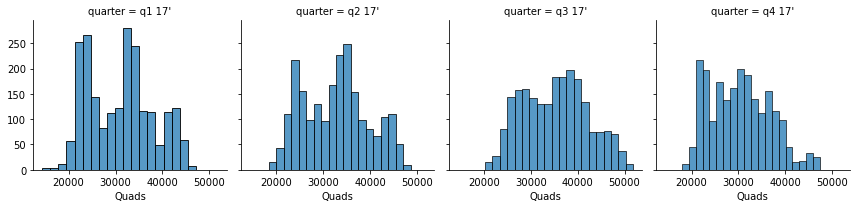

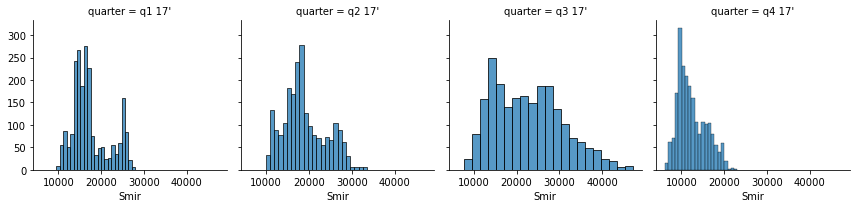

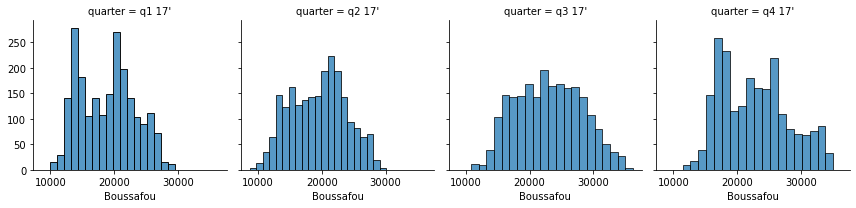

In [22]:
#Stromverbrauch der drei Region quarteilsweise
regionen= ['Quads', 'Smir','Boussafou']
for region in regionen:
    g = sns.FacetGrid(df_power_hour, col="quarter")
    g.map(sns.histplot, region)
plt.show()

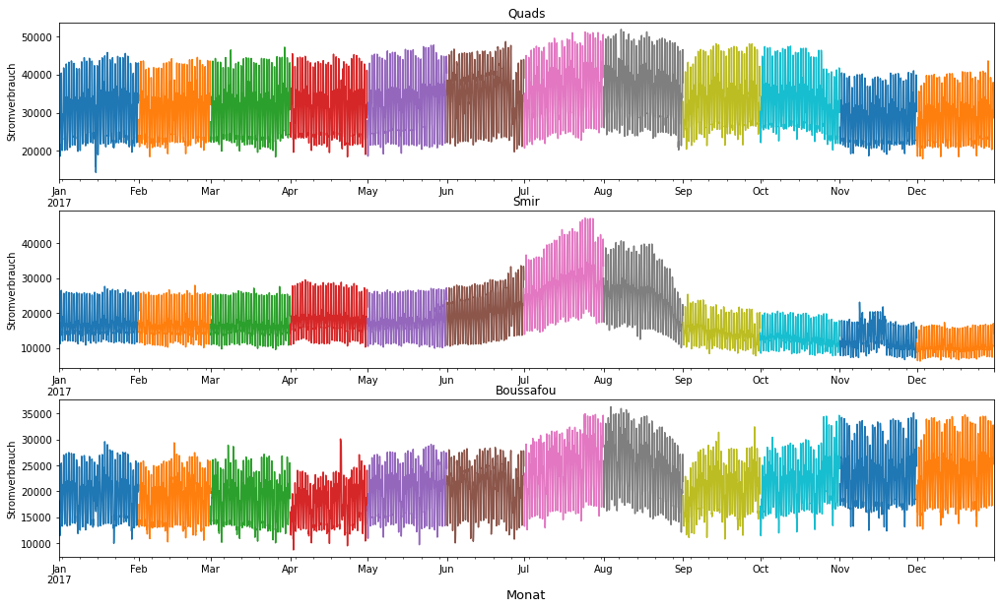

In [23]:
fig, axes = plt.subplots(nrows=3, figsize=(17, 10))
df_month_Smir = df_power_hour.groupby('month')['Smir']
df_month_Quads= df_power_hour.groupby('month')['Quads']
df_month_Boussafou= df_power_hour.groupby('month')['Boussafou']
df_month_Quads.plot(ax=axes[0]); 
axes[0].set_title('Quads')
df_month_Smir.plot(ax=axes[1]); 
axes[1].set_title('Smir')
df_month_Boussafou.plot(ax=axes[2]); 
axes[2].set_title('Boussafou')
for ax in axes:
    ax.set_xlabel('Monat',fontsize=13)
    ax.set_ylabel('Stromverbrauch')
plt.show()

In [24]:
import plotly.graph_objects as go
fig = go.Figure(data=go.Splom(
                dimensions=[dict(label='Quads',
                                 values=df_power_hour['Quads']),
                            dict(label='Smir',
                                 values=df_power_hour['Smir']),
                            dict(label='Boussafou',
                                 values=df_power_hour['Boussafou']),
                            dict(label='Temperature',
                                 values=df_power_hour['Temperature']),
                            dict(label='hour',
                                 values=df_power_hour['hour']),
                            dict(label='weekday',
                                 values=df_power_hour['weekday']),
                            dict(label='month',
                                 values=df_power_hour['month'])],
                showupperhalf=False, # remove plots on diagonal
                text=df_power_hour['month'],
                marker=dict(color=df_power_hour['month'],
                            showscale=True, # colors encode categorical variables
                            line_color='white', line_width=0.5)
                ))

fig.update_layout(
    title="Scatter matrix",
    title_x=0.5,
    width=1000,
    height=1000,
    annotations=[dict(
          x=1.05,
          y=1.02,
          align="right",
          valign="top",
          text='Colorbar',
          showarrow=False,
          xref="paper",
          yref="paper",
          xanchor="center",
          yanchor="top"
        )]
)
fig.show()

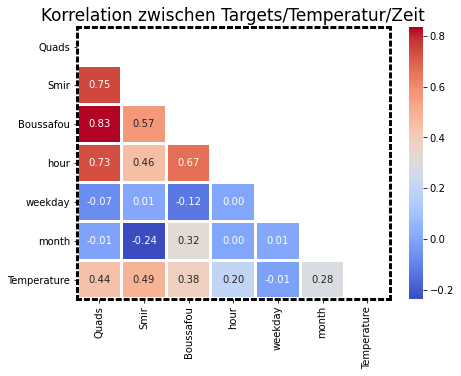

In [25]:
#Correlation matrix: lower triangle seaborn heatmap
plt.figure(figsize=(7,5))
region_time = df_power_hour[['Quads','Smir','Boussafou','hour','weekday','month','Temperature']]
corr_mx = region_time.corr() 
matrix = np.triu(corr_mx) 
res=sns.heatmap(corr_mx, mask=matrix, annot=True, fmt='.2f',linewidths=2, cmap="coolwarm")

for _, spine in res.spines.items(): 
    spine.set_visible(True) 
    spine.set_linewidth(3)
    spine.set_linestyle("dotted")  
    
plt.title("Korrelation zwischen Targets/Temperatur/Zeit", fontsize =17)   
plt.show()

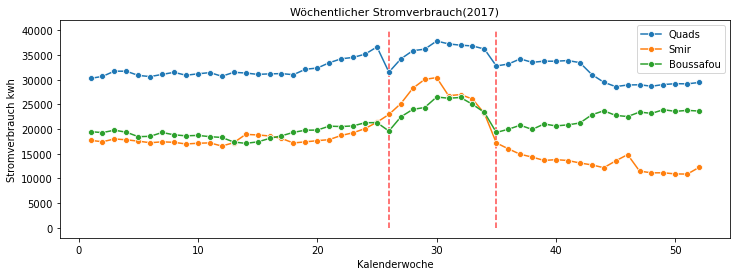

In [26]:
#Wöchentlciher Stromverbrauch in den drei Regionen
regionen= ['Quads', 'Smir','Boussafou']
plt.figure(figsize=(12,4))
for region in regionen:
    sns.lineplot(data=df_power_hour, x='weekofyear', y=region, label=region,ci=None, marker='o' )

plt.vlines(26,0,40000,linestyles ="dashed",alpha=0.7,colors="r")
plt.vlines(35,0,40000,linestyles ="dashed",alpha=0.7,colors="r")
plt.title('Wöchentlicher Stromverbrauch(2017)', fontsize=11)
plt.xlabel('Kalenderwoche')
plt.ylabel('Stromverbrauch kwh')
plt.legend()
plt.show()

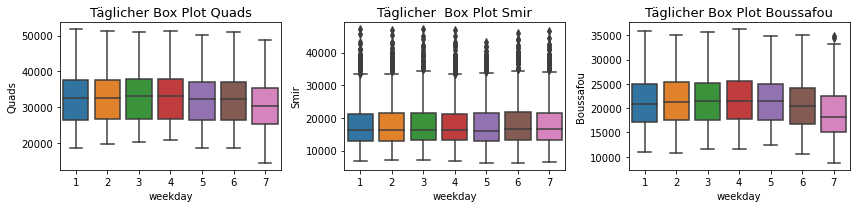

In [27]:
#Täglicher Stromverbrauch in den drei Regionen
fig, axs = plt.subplots(1,3,figsize=(12,3))
sns.boxplot(x='weekday', y='Quads', data=df_power_hour, ax=axs[0])
axs[0].set_title('Täglicher Box Plot Quads', fontsize=13)
sns.boxplot(x='weekday', y='Smir', data=df_power_hour, ax=axs[1])
axs[1].set_title('Täglicher  Box Plot Smir', fontsize=13)
sns.boxplot(x='weekday', y='Boussafou', data=df_power_hour, ax=axs[2])
axs[2].set_title('Täglicher Box Plot Boussafou', fontsize=13)
fig.tight_layout()

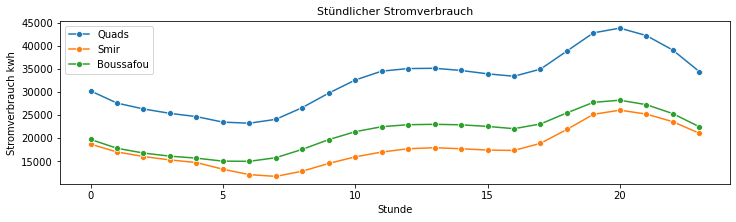

In [28]:
#Stündlicher Stromverbrauch in den drei Regionen
regionen= ['Quads', 'Smir','Boussafou']
plt.figure(figsize=(12,3))
for region in regionen:
    sns.lineplot(data=df_power_hour, x='hour', y=region, label=region, ci=None, marker='o')
plt.title('Stündlicher Stromverbrauch', fontsize=11)
plt.xlabel('Stunde')
plt.ylabel('Stromverbrauch kwh')
plt.legend()
plt.show()